<a href="https://colab.research.google.com/github/Karthika1915/certificateverification/blob/main/GAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!git clone https://github.com/Gurupatil0003/FakeFace

Cloning into 'FakeFace'...
remote: Enumerating objects: 364, done.
remote: Total 364 (delta 0), reused 0 (delta 0), pack-reused 364 (from 1)
Receiving objects: 100% (364/364), 454.61 MiB | 33.53 MiB/s, done.
Updating files: 100% (362/362), done.


two architecture-generator(noise value)-small img ,discriminator-it real or fake

In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Flatten,Dense,Conv2D,Conv2DTranspose,Input,Reshape,BatchNormalization,LeakyReLU

neg-relu,training phase-batchnormalization
+1->-1 tanh

In [ ]:
data_ds=tf.keras.utils.image_dataset_from_directory("/content/FakeFace",
                                                    image_size=(64,64),
                                                    batch_size=64,
                                                    label_mode=None).map(lambda x:(tf.cast(x,tf.float32)/127.5)-1).prefetch(tf.data.AUTOTUNE)

Found 362 files.


In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Dense, Reshape, Conv2DTranspose, BatchNormalization, LeakyReLU, Conv2D, Flatten

# Generator
def built_generator(latent=100):
    return tf.keras.models.Sequential([
        Input((latent,)),
        Dense(4*4*512, use_bias=False),
        Reshape((4,4,512)),
        Conv2DTranspose(256, 4, 2, "same", use_bias=False),
        BatchNormalization(),
        LeakyReLU(),
        Conv2DTranspose(128, 4, 2, "same", use_bias=False),
        BatchNormalization(),
        LeakyReLU(),
        Conv2DTranspose(64, 4, 2, "same", use_bias=False),
        BatchNormalization(),
        LeakyReLU(),
        Conv2DTranspose(3, 4, 2, "same", activation="tanh")
    ])

# Discriminator
def built_discriminator(img=64):
    return tf.keras.models.Sequential([
        Input((img,img,3)),
        Conv2D(64, 4, 2, "same"),
        LeakyReLU(0.2),
        Conv2D(128, 4, 2, "same"),
        LeakyReLU(0.2),
        Conv2D(256, 4, 2, "same"),
        LeakyReLU(0.2),
        Conv2D(512, 4, 2, "same"),
        LeakyReLU(0.2),
        Flatten(),
        Dense(1)  # output logits
    ])

# Instantiate models
G, D = built_generator(), built_discriminator()


upsampling-generator reverse for discriminator

In [ ]:
loss_fn = tf.keras.losses.BinaryCrossentropy(from_logits=True)
g_opt = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
d_opt = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

@tf.function
def data_set(real):
    noise = tf.random.normal([64, 100])

    with tf.GradientTape() as g_tape, tf.GradientTape() as d_tape:
        fake = G(noise, training=True)

        r_out = D(real, training=True)
        f_out = D(fake, training=True)

        g_loss = loss_fn(tf.ones_like(f_out), f_out)
        d_loss = (loss_fn(tf.ones_like(r_out), r_out) +
                  loss_fn(tf.zeros_like(f_out), f_out))

    g_grads = g_tape.gradient(g_loss, G.trainable_variables)
    d_grads = d_tape.gradient(d_loss, D.trainable_variables)

    g_opt.apply_gradients(zip(g_grads, G.trainable_variables))
    d_opt.apply_gradients(zip(d_grads, D.trainable_variables))

    return g_loss, d_loss


Epoch 2, Generator Loss: 3.6685, Discriminator Loss: 0.0535


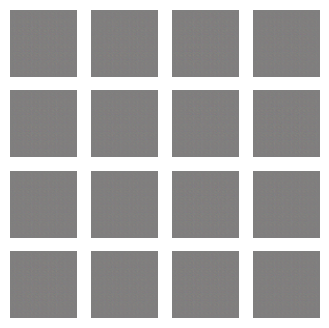

Epoch 4, Generator Loss: 6.8502, Discriminator Loss: 0.1091


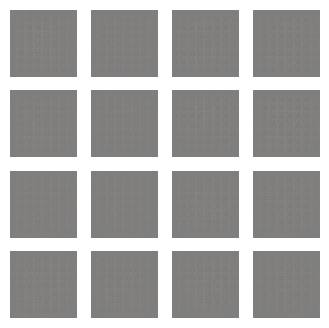

Epoch 6, Generator Loss: 5.2342, Discriminator Loss: 0.0311


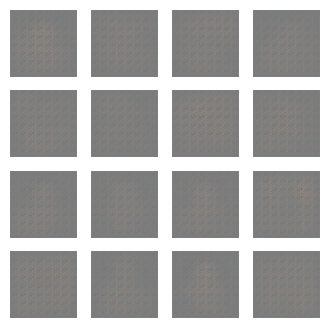

Epoch 8, Generator Loss: 4.7300, Discriminator Loss: 0.0597


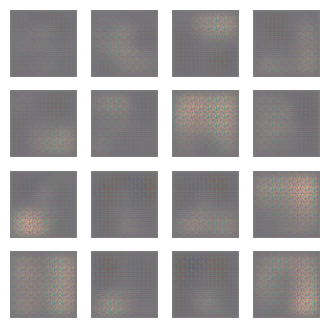

Epoch 10, Generator Loss: 3.0815, Discriminator Loss: 0.2237


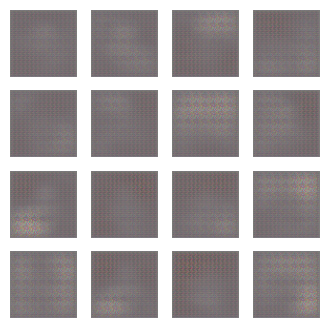

Epoch 12, Generator Loss: 2.6754, Discriminator Loss: 0.4614


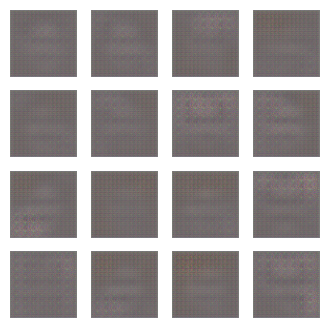

Epoch 14, Generator Loss: 1.4037, Discriminator Loss: 0.7419


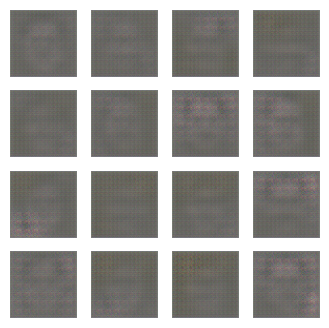

Epoch 16, Generator Loss: 1.2502, Discriminator Loss: 0.5687


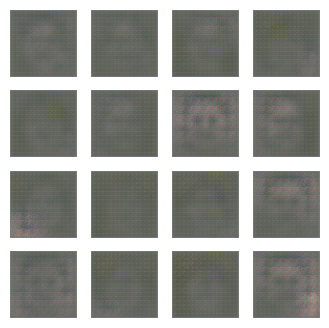

Epoch 18, Generator Loss: 1.4254, Discriminator Loss: 0.6967


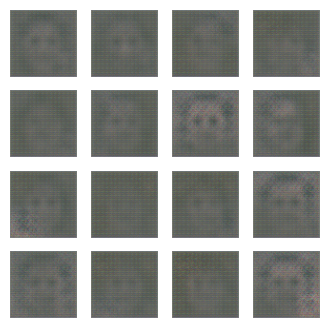

Epoch 20, Generator Loss: 1.3136, Discriminator Loss: 0.6192


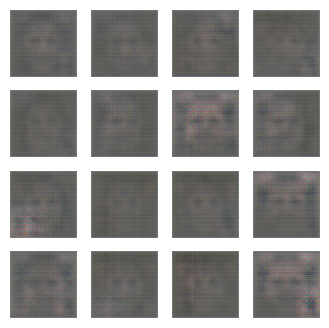

Epoch 22, Generator Loss: 0.7221, Discriminator Loss: 1.0301


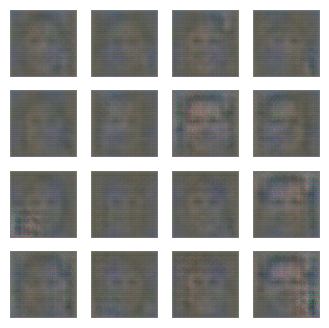

Epoch 24, Generator Loss: 1.9063, Discriminator Loss: 1.0618


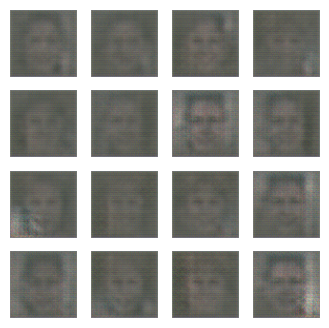

Epoch 26, Generator Loss: 0.5656, Discriminator Loss: 1.1863


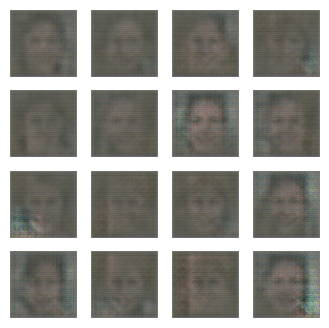

Epoch 28, Generator Loss: 2.1797, Discriminator Loss: 1.4121


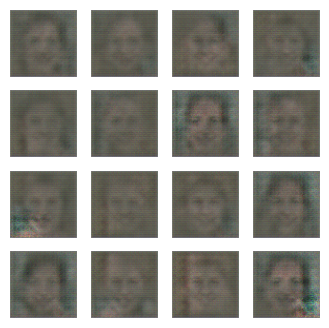

Epoch 30, Generator Loss: 1.1876, Discriminator Loss: 1.1703


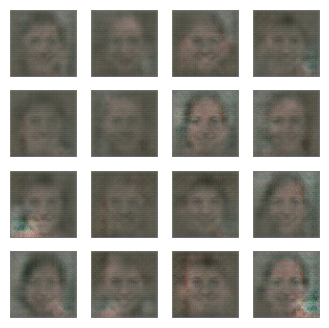

Epoch 32, Generator Loss: 1.4528, Discriminator Loss: 1.0255


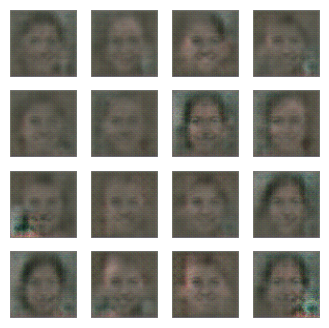

Epoch 34, Generator Loss: 1.1568, Discriminator Loss: 0.9999


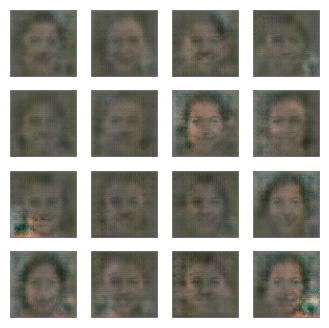

Epoch 36, Generator Loss: 0.9249, Discriminator Loss: 1.1411


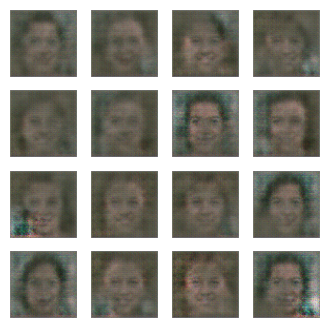

Epoch 38, Generator Loss: 0.9099, Discriminator Loss: 0.9962


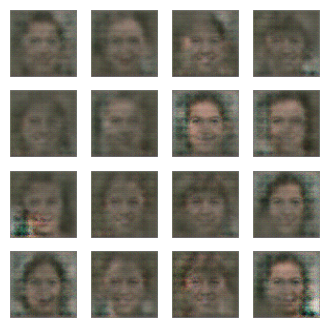

Epoch 40, Generator Loss: 0.9136, Discriminator Loss: 1.0560


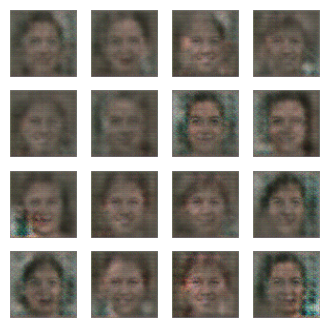

Epoch 42, Generator Loss: 0.9473, Discriminator Loss: 1.0069


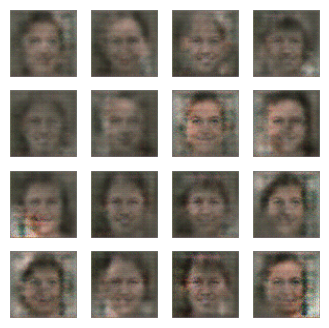

Epoch 44, Generator Loss: 0.9228, Discriminator Loss: 1.0890


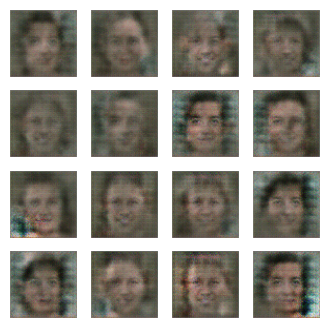

Epoch 46, Generator Loss: 0.8148, Discriminator Loss: 1.0439


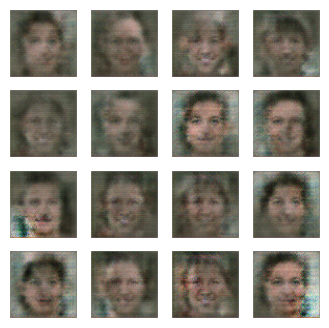

Epoch 48, Generator Loss: 1.6975, Discriminator Loss: 1.4240


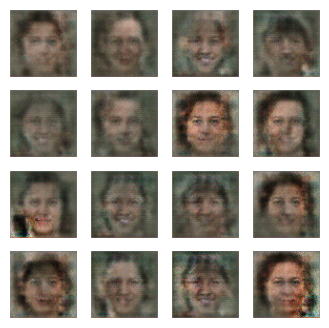

Epoch 50, Generator Loss: 1.0066, Discriminator Loss: 1.0067


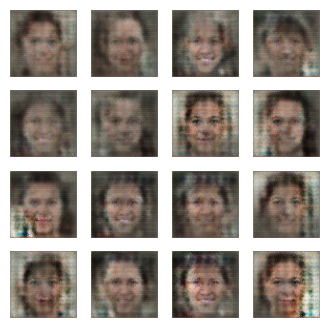

Epoch 52, Generator Loss: 0.6906, Discriminator Loss: 1.1594


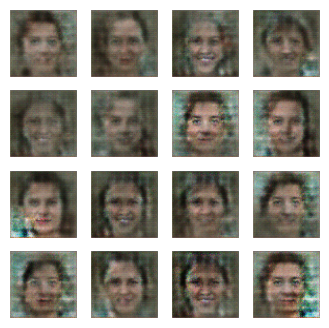

Epoch 54, Generator Loss: 1.1821, Discriminator Loss: 1.2909


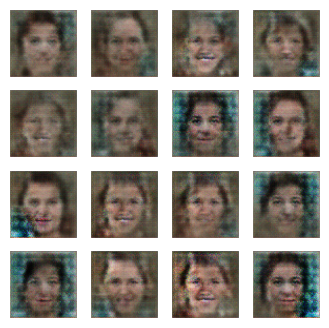

Epoch 56, Generator Loss: 1.4530, Discriminator Loss: 1.6403


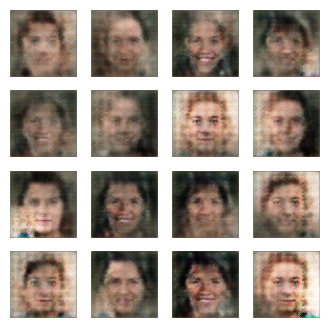

Epoch 58, Generator Loss: 0.8773, Discriminator Loss: 1.2206


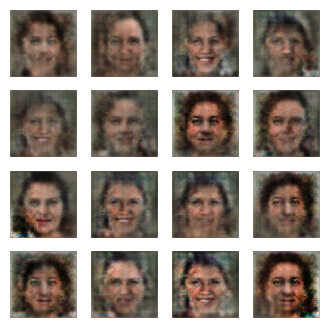

Epoch 60, Generator Loss: 1.5096, Discriminator Loss: 1.3405


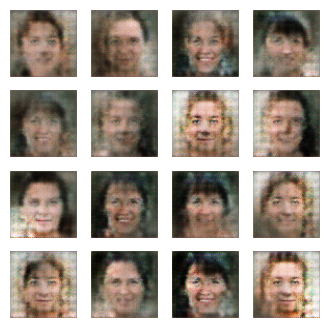

Epoch 62, Generator Loss: 0.9600, Discriminator Loss: 1.1148


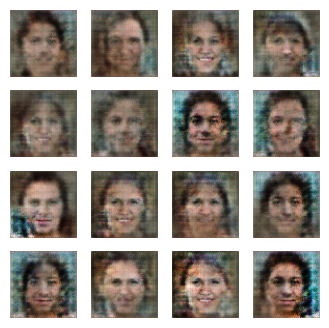

Epoch 64, Generator Loss: 0.9227, Discriminator Loss: 1.0503


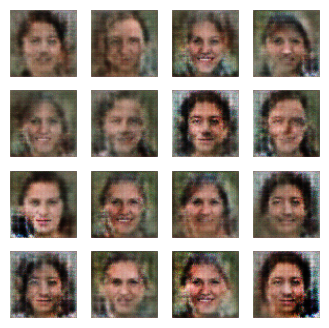

Epoch 66, Generator Loss: 0.9831, Discriminator Loss: 0.9779


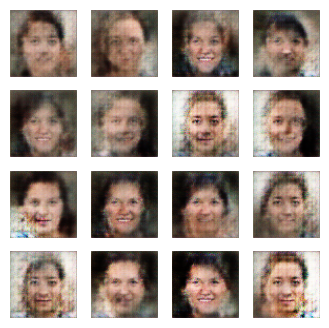

Epoch 68, Generator Loss: 0.6520, Discriminator Loss: 1.2281


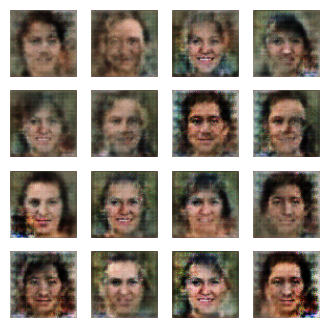

Epoch 70, Generator Loss: 0.8672, Discriminator Loss: 1.1635


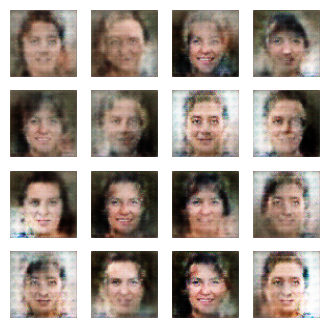

Epoch 72, Generator Loss: 1.1756, Discriminator Loss: 1.1394


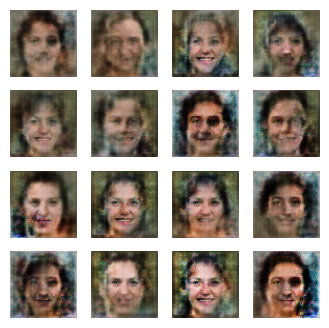

Epoch 74, Generator Loss: 1.1668, Discriminator Loss: 1.0971


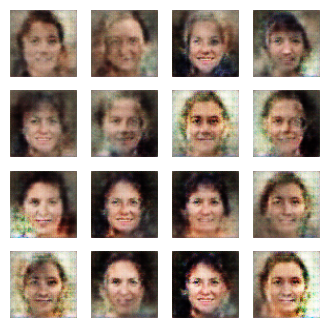

Epoch 76, Generator Loss: 0.8139, Discriminator Loss: 1.0991


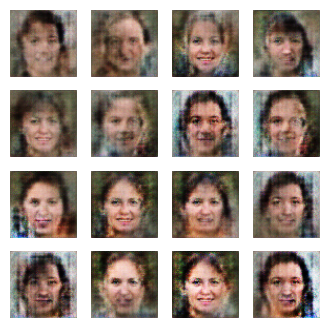

Epoch 78, Generator Loss: 0.9033, Discriminator Loss: 1.1243


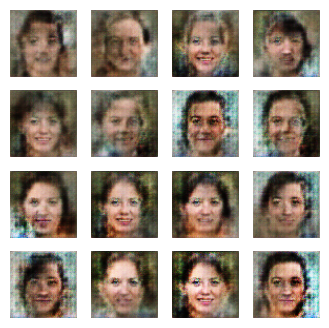

Epoch 80, Generator Loss: 0.8938, Discriminator Loss: 0.9958


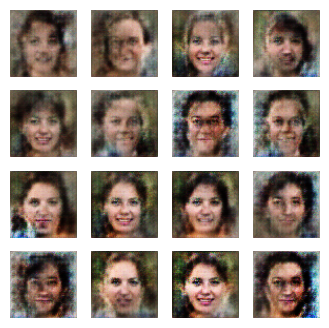

Epoch 82, Generator Loss: 1.1108, Discriminator Loss: 1.0806


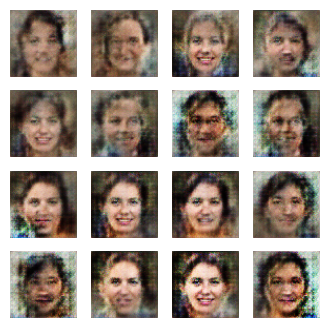

Epoch 84, Generator Loss: 0.8536, Discriminator Loss: 1.1200


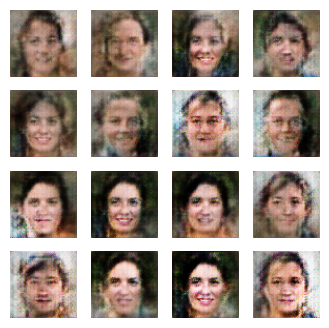

Epoch 86, Generator Loss: 0.9550, Discriminator Loss: 0.9809


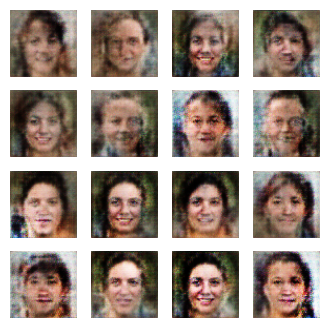

Epoch 88, Generator Loss: 1.2760, Discriminator Loss: 1.2343


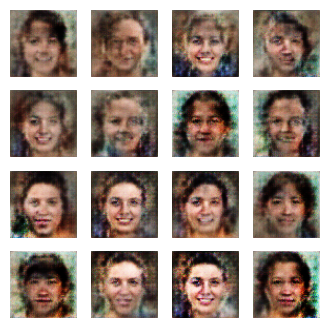

Epoch 90, Generator Loss: 0.7037, Discriminator Loss: 1.1563


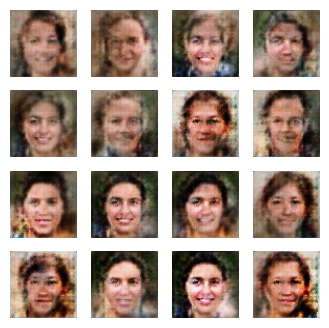

Epoch 92, Generator Loss: 0.9142, Discriminator Loss: 1.0138


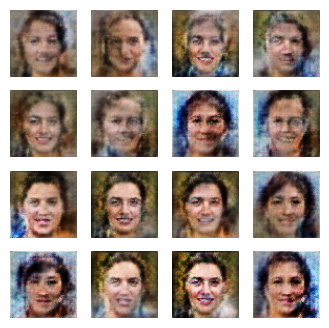

Epoch 94, Generator Loss: 1.3694, Discriminator Loss: 1.0297


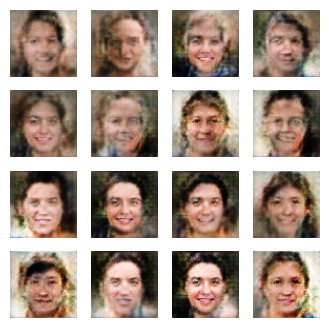

Epoch 96, Generator Loss: 0.9235, Discriminator Loss: 1.0482


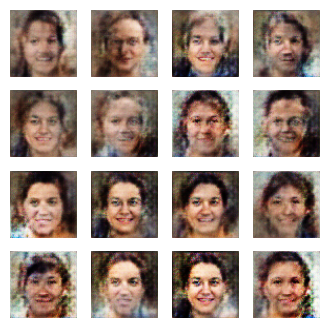

Epoch 98, Generator Loss: 1.0458, Discriminator Loss: 1.0075


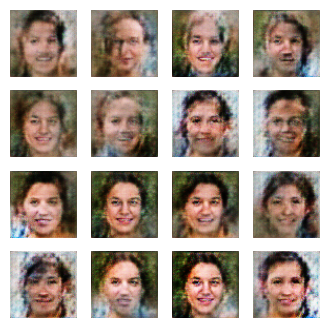

Epoch 100, Generator Loss: 1.1328, Discriminator Loss: 0.9101


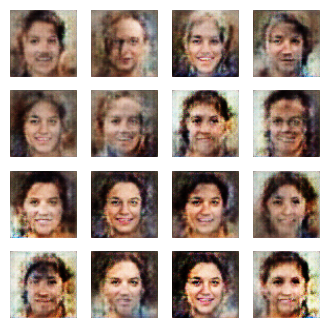

Epoch 102, Generator Loss: 1.4263, Discriminator Loss: 1.0484


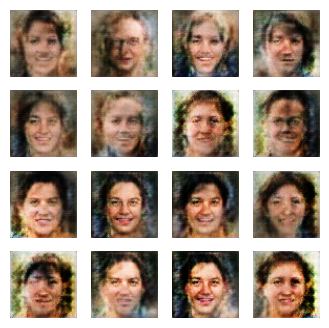

Epoch 104, Generator Loss: 0.5184, Discriminator Loss: 1.2973


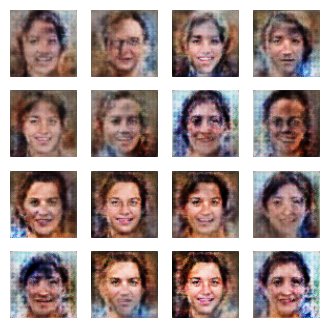

Epoch 106, Generator Loss: 1.1461, Discriminator Loss: 0.9825


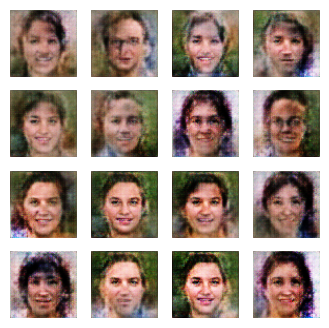

Epoch 108, Generator Loss: 0.8891, Discriminator Loss: 0.9461


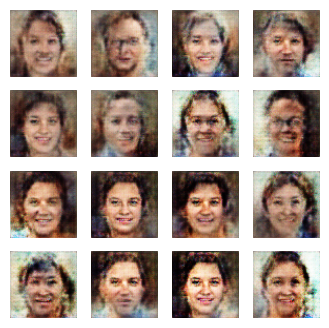

Epoch 110, Generator Loss: 0.5556, Discriminator Loss: 1.1284


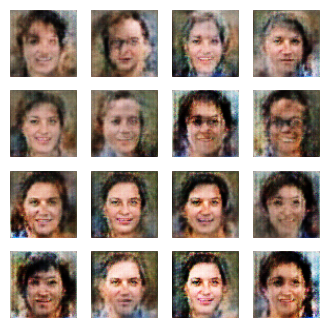

Epoch 112, Generator Loss: 1.7029, Discriminator Loss: 1.1351


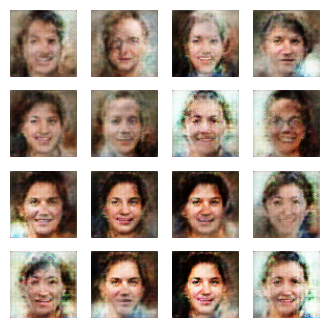

Epoch 114, Generator Loss: 0.5854, Discriminator Loss: 1.1228


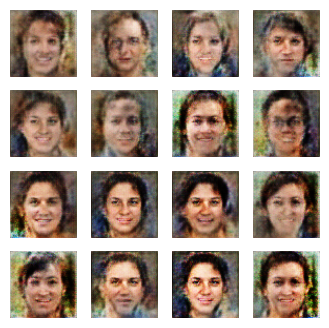

Epoch 116, Generator Loss: 0.5679, Discriminator Loss: 1.1112


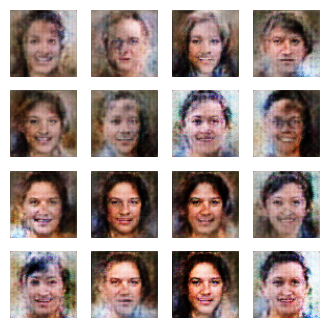

Epoch 118, Generator Loss: 0.6634, Discriminator Loss: 1.0608


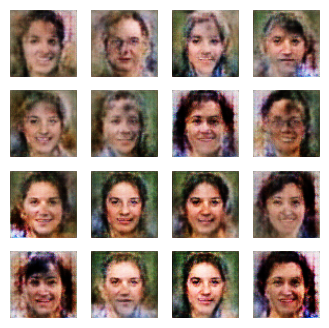

Epoch 120, Generator Loss: 1.4528, Discriminator Loss: 0.9225


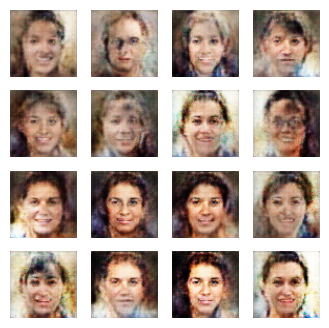

Epoch 122, Generator Loss: 1.1678, Discriminator Loss: 0.9834


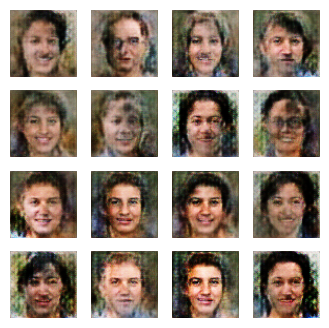

Epoch 124, Generator Loss: 0.6824, Discriminator Loss: 1.0543


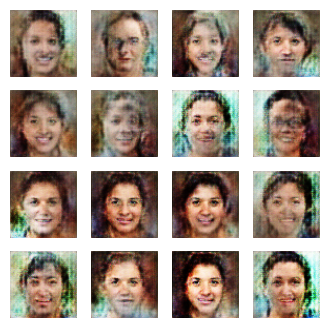

Epoch 126, Generator Loss: 1.1376, Discriminator Loss: 0.9182


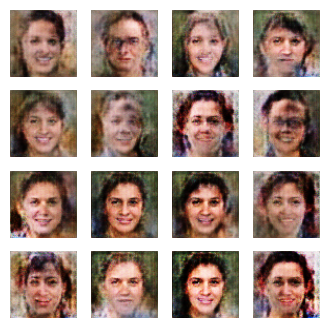

Epoch 128, Generator Loss: 1.5930, Discriminator Loss: 1.0006


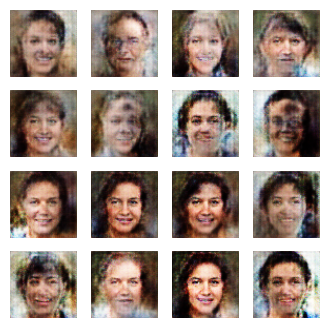

Epoch 130, Generator Loss: 0.8965, Discriminator Loss: 0.9264


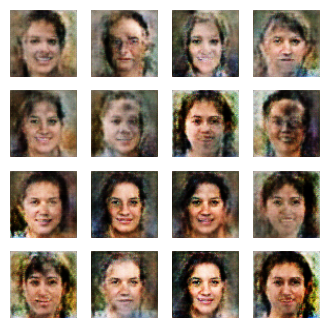

Epoch 132, Generator Loss: 1.4254, Discriminator Loss: 0.8373


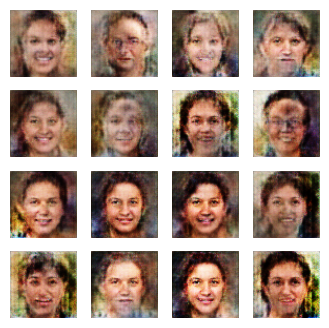

Epoch 134, Generator Loss: 1.4679, Discriminator Loss: 1.0287


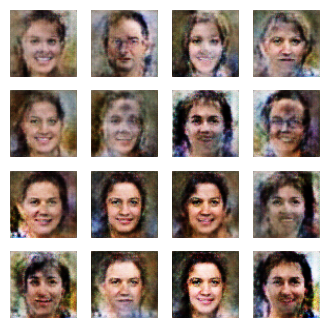

Epoch 136, Generator Loss: 1.4179, Discriminator Loss: 0.8434


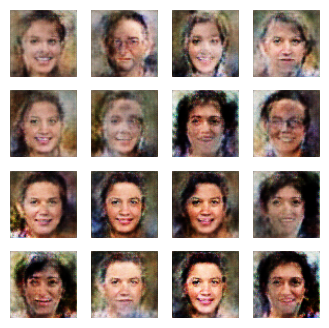

Epoch 138, Generator Loss: 1.1363, Discriminator Loss: 0.9114


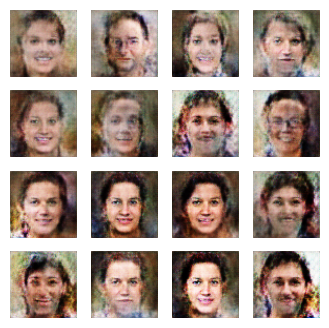

Epoch 140, Generator Loss: 1.0760, Discriminator Loss: 0.8685


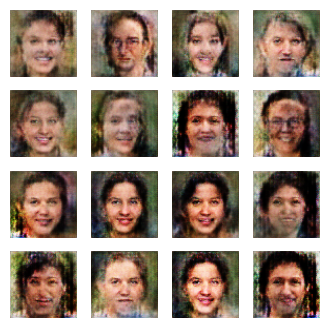

Epoch 142, Generator Loss: 0.8174, Discriminator Loss: 1.0370


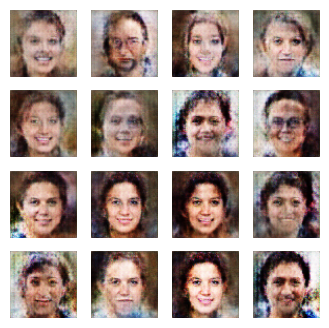

Epoch 144, Generator Loss: 0.7597, Discriminator Loss: 0.9610


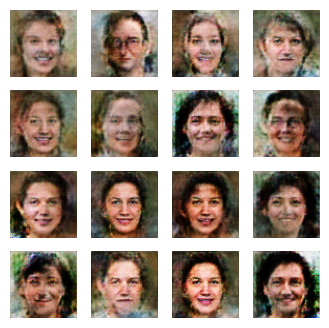

Epoch 146, Generator Loss: 0.3938, Discriminator Loss: 1.4294


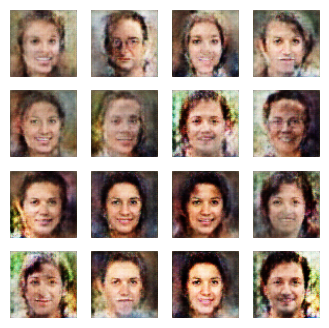

Epoch 148, Generator Loss: 0.9602, Discriminator Loss: 0.9055


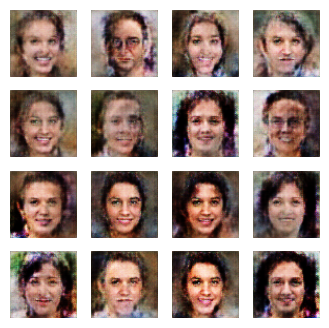

Epoch 150, Generator Loss: 1.0166, Discriminator Loss: 0.9434


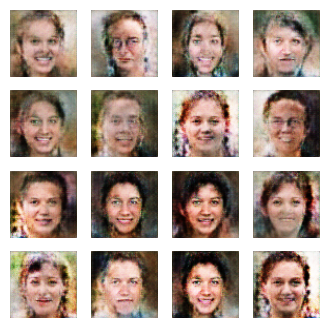

Epoch 152, Generator Loss: 1.3588, Discriminator Loss: 0.8041


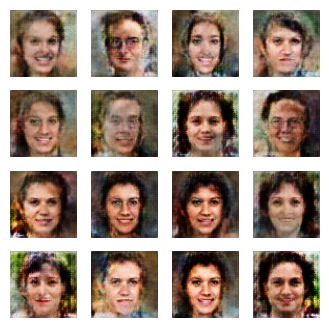

Epoch 154, Generator Loss: 0.8422, Discriminator Loss: 0.9891


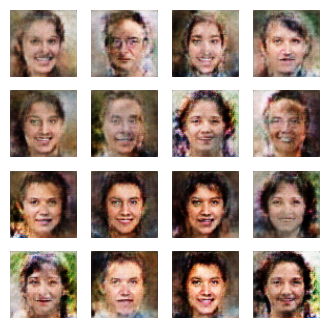

Epoch 156, Generator Loss: 1.1061, Discriminator Loss: 0.9494


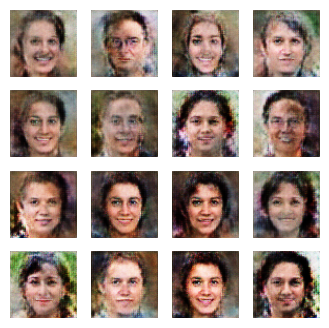

Epoch 158, Generator Loss: 1.6252, Discriminator Loss: 0.9696


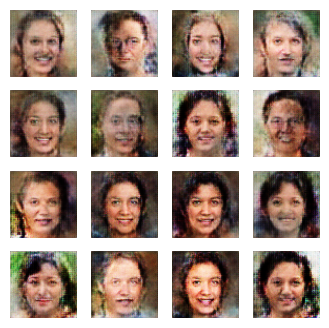

Epoch 160, Generator Loss: 0.9272, Discriminator Loss: 0.9044


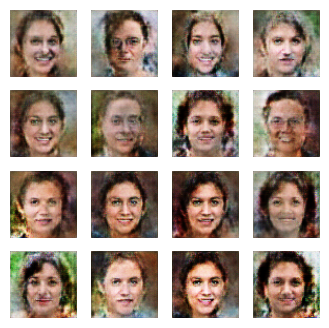

Epoch 162, Generator Loss: 1.6580, Discriminator Loss: 1.0268


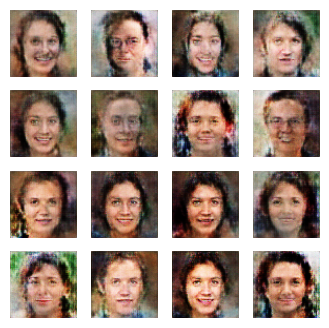

Epoch 164, Generator Loss: 1.2531, Discriminator Loss: 0.8839


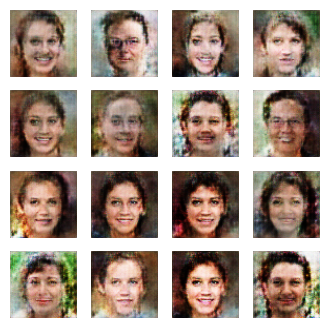

Epoch 166, Generator Loss: 0.7234, Discriminator Loss: 0.9861


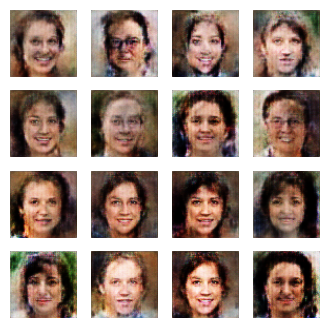

Epoch 168, Generator Loss: 1.9620, Discriminator Loss: 0.9354


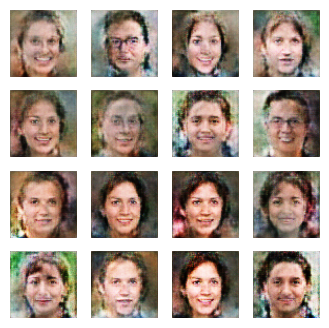

Epoch 170, Generator Loss: 0.7940, Discriminator Loss: 0.9645


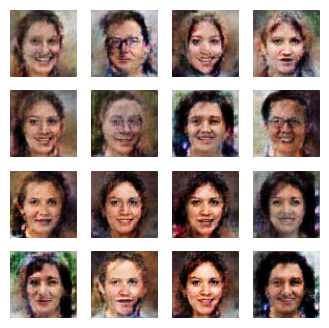

Epoch 172, Generator Loss: 1.6932, Discriminator Loss: 0.8272


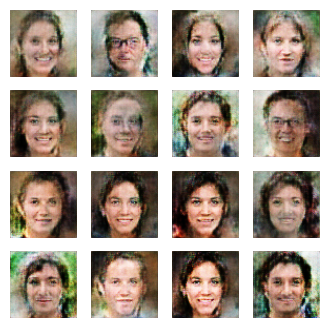

Epoch 174, Generator Loss: 0.6843, Discriminator Loss: 1.0128


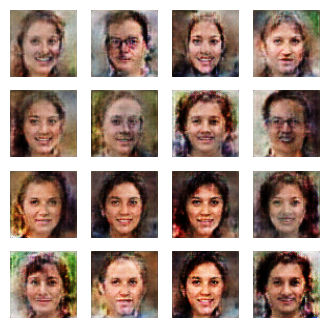

Epoch 176, Generator Loss: 1.3497, Discriminator Loss: 0.8276


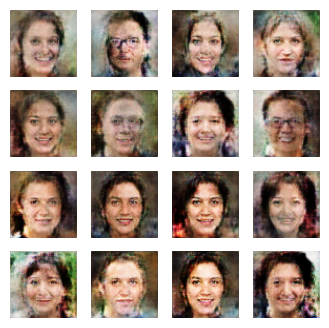

Epoch 178, Generator Loss: 2.1321, Discriminator Loss: 0.9698


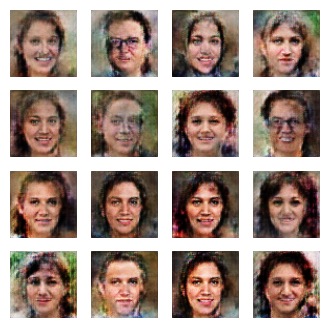

Epoch 180, Generator Loss: 0.6923, Discriminator Loss: 0.9793


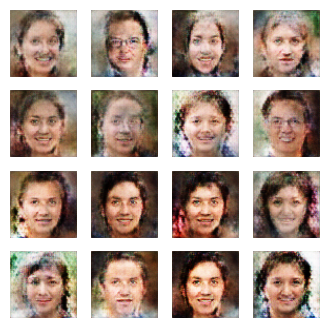

Epoch 182, Generator Loss: 1.7173, Discriminator Loss: 0.9234


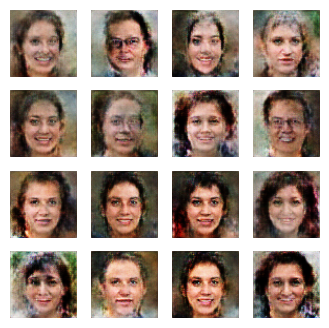

Epoch 184, Generator Loss: 1.1205, Discriminator Loss: 0.9027


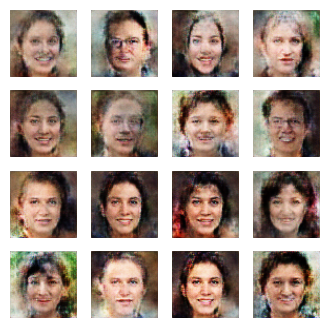

Epoch 186, Generator Loss: 1.0179, Discriminator Loss: 0.8695


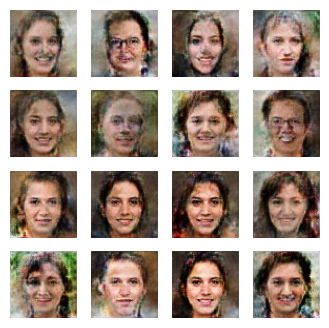

Epoch 188, Generator Loss: 0.6861, Discriminator Loss: 1.0355


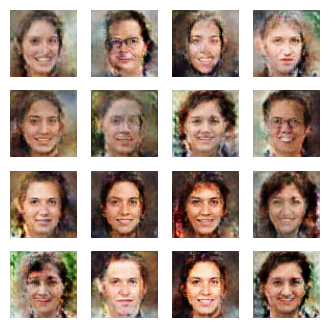

Epoch 190, Generator Loss: 1.8344, Discriminator Loss: 0.8354


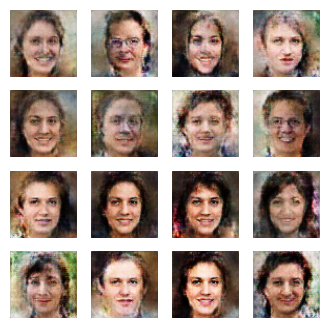

Epoch 192, Generator Loss: 0.7382, Discriminator Loss: 0.9784


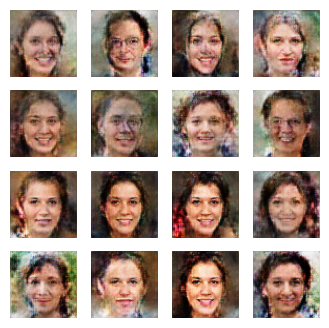

Epoch 194, Generator Loss: 0.8282, Discriminator Loss: 0.8636


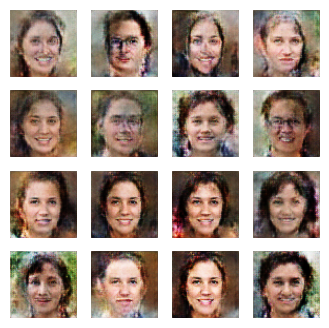

Epoch 196, Generator Loss: 1.5121, Discriminator Loss: 0.7904


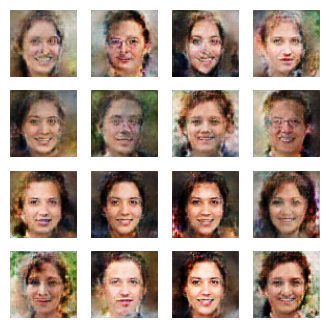

Epoch 198, Generator Loss: 1.1755, Discriminator Loss: 0.8047


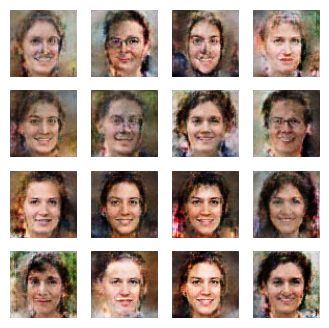

Epoch 200, Generator Loss: 1.2289, Discriminator Loss: 0.8015


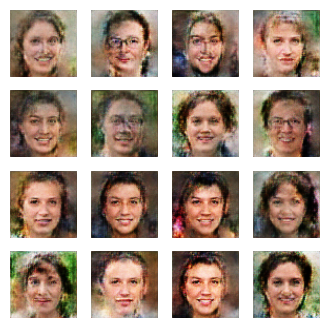

Epoch 202, Generator Loss: 1.7788, Discriminator Loss: 0.7683


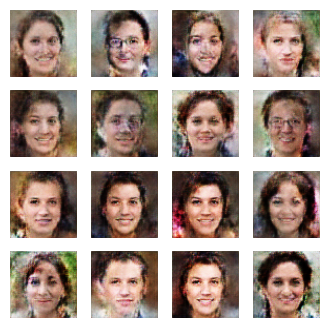

Epoch 204, Generator Loss: 1.4448, Discriminator Loss: 0.7870


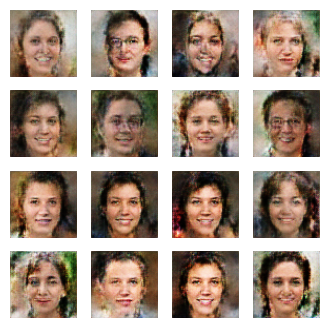

Epoch 206, Generator Loss: 1.0633, Discriminator Loss: 0.8426


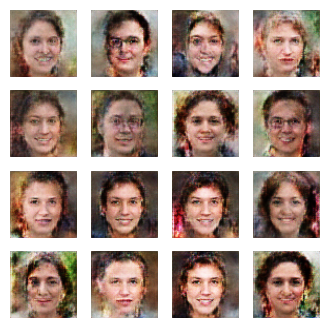

Epoch 208, Generator Loss: 0.7970, Discriminator Loss: 1.0530


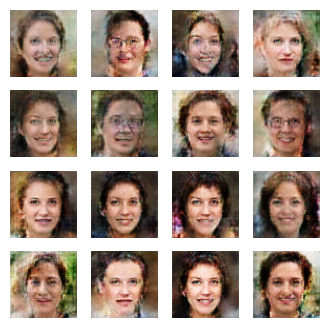

Epoch 210, Generator Loss: 1.3334, Discriminator Loss: 0.9977


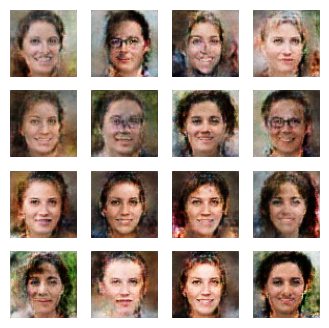

Epoch 212, Generator Loss: 2.9375, Discriminator Loss: 1.5053


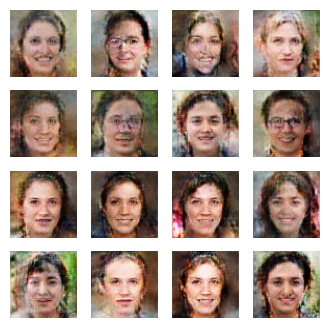

Epoch 214, Generator Loss: 1.3755, Discriminator Loss: 0.8723


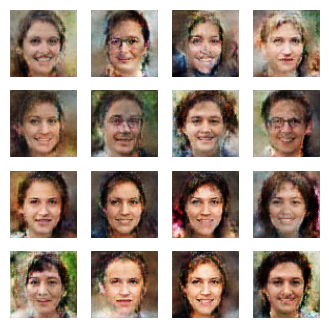

Epoch 216, Generator Loss: 1.6759, Discriminator Loss: 1.0030


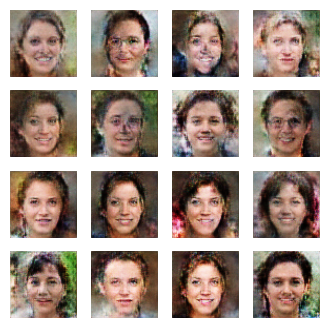

Epoch 218, Generator Loss: 1.0958, Discriminator Loss: 0.8101


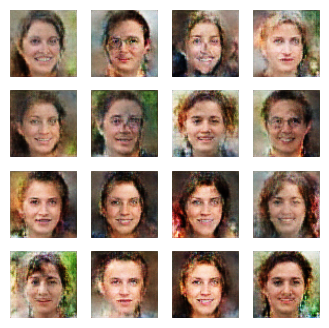

Epoch 220, Generator Loss: 1.4225, Discriminator Loss: 0.8407


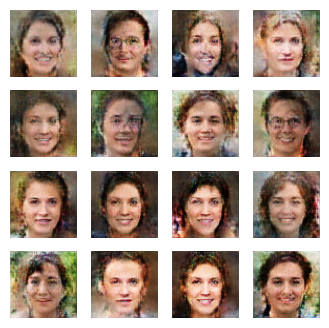

Epoch 222, Generator Loss: 1.0118, Discriminator Loss: 0.8350


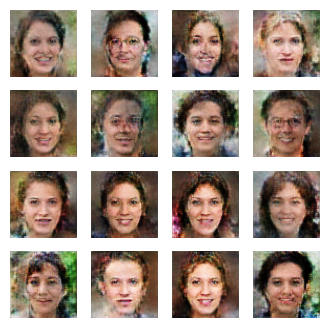

Epoch 224, Generator Loss: 0.7056, Discriminator Loss: 1.0325


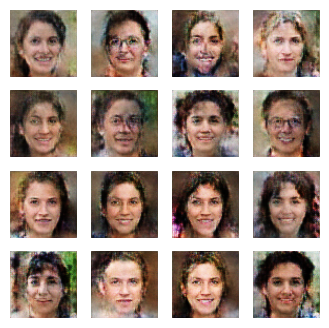

Epoch 226, Generator Loss: 1.1769, Discriminator Loss: 0.6448


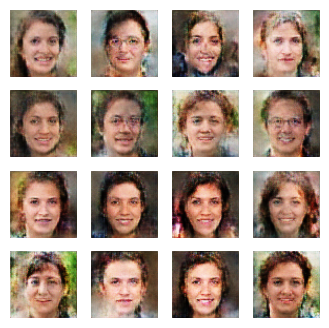

Epoch 228, Generator Loss: 1.9546, Discriminator Loss: 0.8342


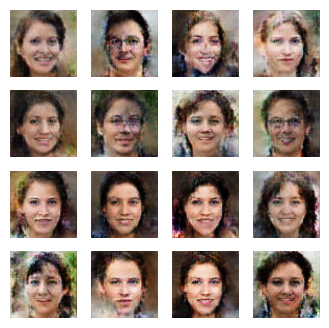

Epoch 230, Generator Loss: 1.8997, Discriminator Loss: 0.6818


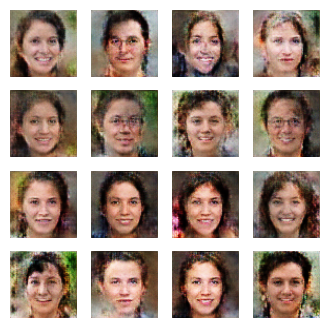

Epoch 232, Generator Loss: 1.1081, Discriminator Loss: 0.7690


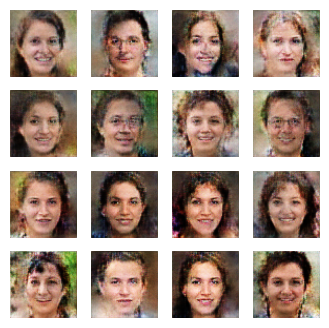

Epoch 234, Generator Loss: 2.3255, Discriminator Loss: 0.9164


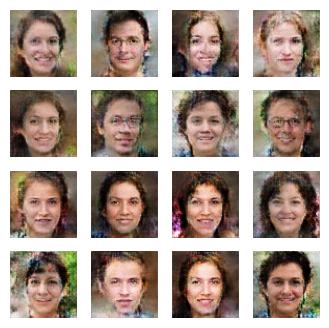

Epoch 236, Generator Loss: 0.7529, Discriminator Loss: 0.9911


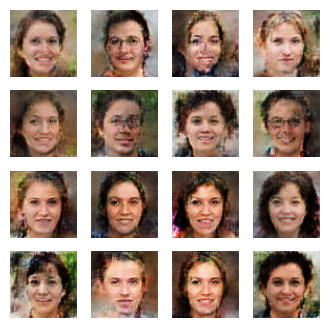

Epoch 238, Generator Loss: 2.0614, Discriminator Loss: 0.6205


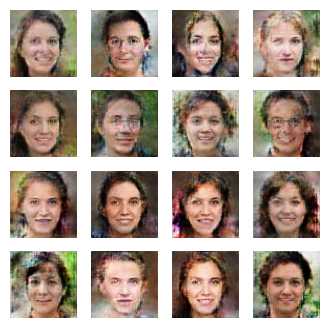

Epoch 240, Generator Loss: 1.6453, Discriminator Loss: 0.7840


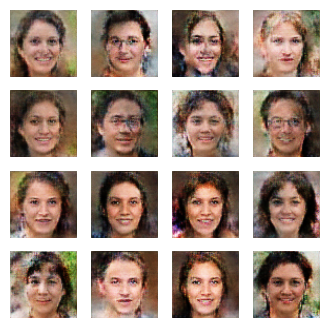

Epoch 242, Generator Loss: 1.7771, Discriminator Loss: 0.6405


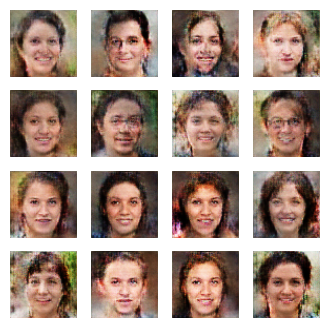

Epoch 244, Generator Loss: 1.1042, Discriminator Loss: 0.7883


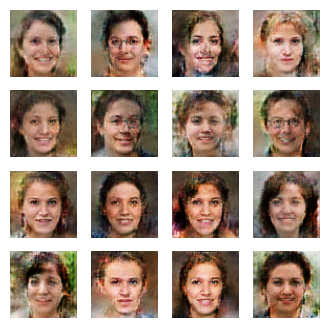

Epoch 246, Generator Loss: 1.0958, Discriminator Loss: 0.8750


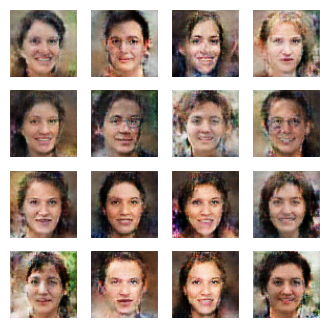

Epoch 248, Generator Loss: 1.2208, Discriminator Loss: 0.6017


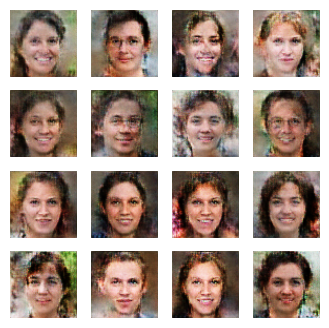

Epoch 250, Generator Loss: 2.4348, Discriminator Loss: 0.8022


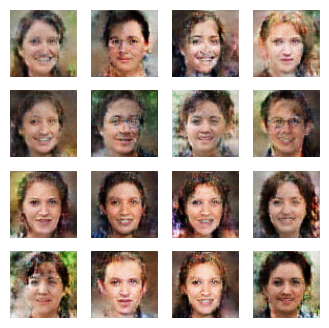

Epoch 252, Generator Loss: 2.0665, Discriminator Loss: 0.8952


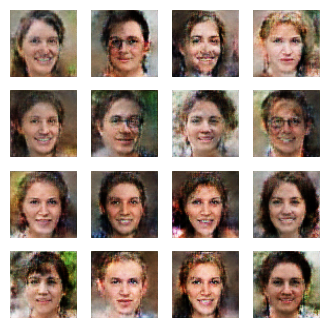

Epoch 254, Generator Loss: 1.3599, Discriminator Loss: 0.8161


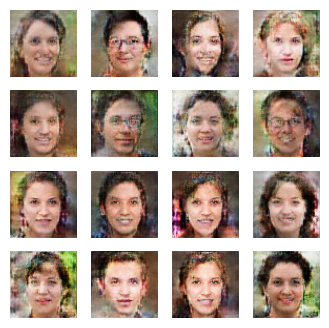

Epoch 256, Generator Loss: 1.3399, Discriminator Loss: 0.6536


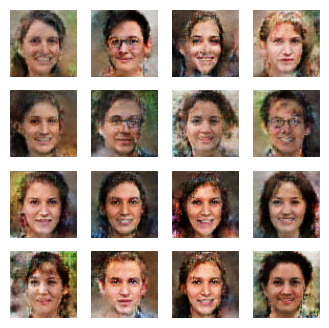

Epoch 258, Generator Loss: 1.8570, Discriminator Loss: 0.6907


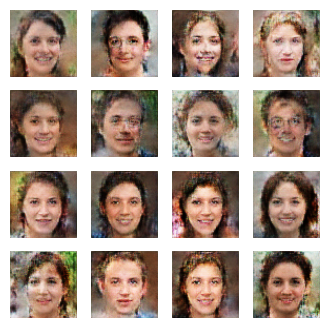

Epoch 260, Generator Loss: 1.8798, Discriminator Loss: 0.7248


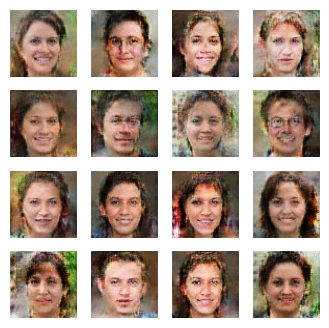

Epoch 262, Generator Loss: 1.2487, Discriminator Loss: 0.7401


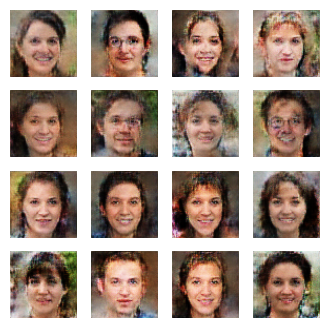

Epoch 264, Generator Loss: 1.0369, Discriminator Loss: 0.6934


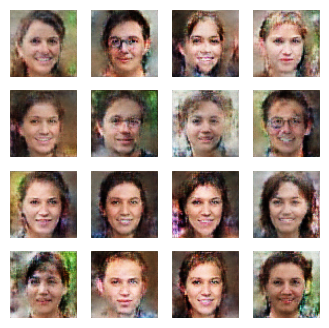

Epoch 266, Generator Loss: 1.9486, Discriminator Loss: 0.7341


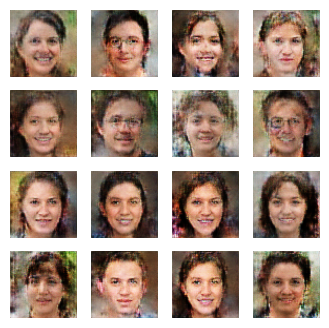

Epoch 268, Generator Loss: 1.9265, Discriminator Loss: 0.5752


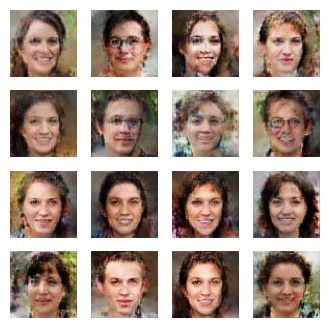

Epoch 270, Generator Loss: 1.9227, Discriminator Loss: 0.7616


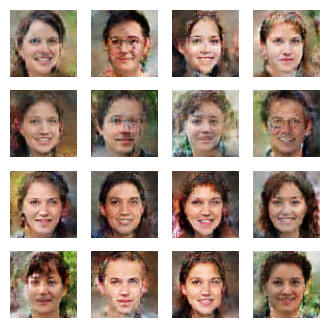

Epoch 272, Generator Loss: 1.2512, Discriminator Loss: 0.6857


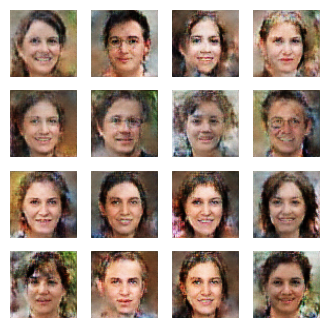

Epoch 274, Generator Loss: 1.2184, Discriminator Loss: 0.6450


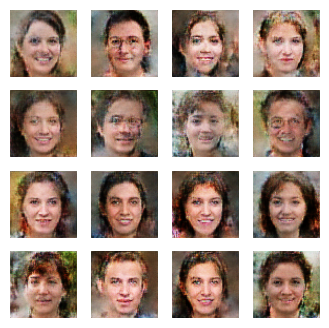

Epoch 276, Generator Loss: 0.9975, Discriminator Loss: 0.8269


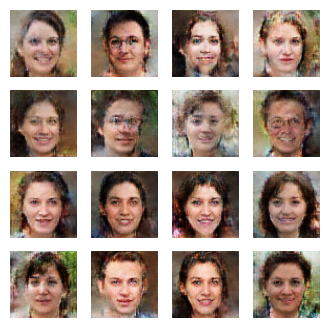

Epoch 278, Generator Loss: 3.0598, Discriminator Loss: 0.9162


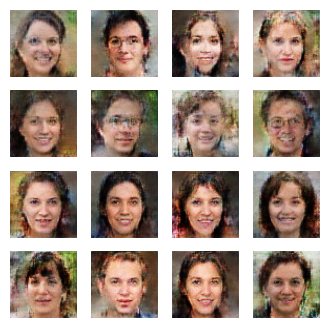

In [ ]:
EPOCHS = 400
import matplotlib.pyplot as plt

seed = tf.random.normal([16, 100])

for e in range(EPOCHS):
    for real in data_ds:
        g_loss, d_loss = data_set(real)   # ✅ correct function name

    if (e + 1) % 2 == 0:
        print(f"Epoch {e+1}, Generator Loss: {g_loss.numpy():.4f}, Discriminator Loss: {d_loss.numpy():.4f}")

        # Generate images
        img = G(seed, training=False)

        # Rescale if using tanh
        img = (img + 1) / 2.0

        plt.figure(figsize=(4,4))
        for i in range(16):
            plt.subplot(4,4,i+1)
            plt.imshow(img[i])
            plt.axis("off")
        plt.show()   # ✅ only once, after plotting all 16 images
